# Notebook para a analise exploratória e tratamento dos dados para o TCC

# Bibliotecas e instalações 

In [3]:
import pandas as pd
import numpy as np

# Gráficas
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [4]:
# Pré-Processamento
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler, MaxAbsScaler, PowerTransformer, QuantileTransformer
from sklearn.model_selection import train_test_split

In [5]:
# Classificação
from imblearn.over_sampling import SMOTE
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn import tree

# Leitura dos dados

In [7]:
dados_cancer= pd.read_csv('prostata_csv.csv', sep = ',', encoding = 'UTF-8',low_memory=False)

In [8]:
dados_cancer.head()

,ESCOLARI,IDADE,SEXO,UFNASC,UFRESID,IBGE,CIDADE,CATEATEND,DTCONSULT,CLINICA,...,REC03,REC04,IBGEATEN,CIDO,DSCCIDO,HABILIT,HABIT11,HABILIT1,HABILIT2,CIDADEH
0,9,72,1,TO,SP,3524402,JACAREI,2,10/4/2016,32,...,NaN,NaN,3524402,80001,NEOPLASIA DE COMPORTAMENTO INCERTO SE BENIGNO ...,1,UNACON,1,1,Jacarei
1,5,67,1,SP,SP,3533007,NOVA GRANADA,2,10/13/2019,32,...,NaN,NaN,3549805,80001,NEOPLASIA DE COMPORTAMENTO INCERTO SE BENIGNO ...,10,"UNACON com Serviþos de Radioterapia, de Hemato...",1,1,SÒo JosÚ do Rio Preto
2,2,97,1,SP,SP,3555406,UBATUBA,2,2/13/2009,24,...,NaN,NaN,3524402,80003,NEOPLASIA MALIGNA,1,UNACON,1,1,Jacarei
3,2,74,1,SP,SP,3524402,JACAREI,2,12/20/2013,24,...,NaN,NaN,3524402,80003,NEOPLASIA MALIGNA,1,UNACON,1,1,Jacarei
4,9,58,1,SP,SP,3524402,JACAREI,2,5/21/2014,24,...,NaN,NaN,3524402,80003,NEOPLASIA MALIGNA,1,UNACON,1,1,Jacarei


In [9]:
dados_cancer.shape

(103198, 100)

# Análise dos Dados

In [11]:
#Copia do DataFrame original
data = dados_cancer.copy()

In [12]:
data.dtypes

ESCOLARI     int64
IDADE        int64
SEXO         int64
UFNASC      object
UFRESID     object
             ...  
HABILIT      int64
HABIT11     object
HABILIT1     int64
HABILIT2     int64
CIDADEH     object
Length: 100, dtype: object

In [13]:
#Verificando por atributos duplicados
data.duplicated().sum()

0

In [14]:
#Verificando por atributos nulos
data.isnull().sum()

ESCOLARI    0
IDADE       0
SEXO        0
UFNASC      0
UFRESID     0
           ..
HABILIT     0
HABIT11     0
HABILIT1    0
HABILIT2    0
CIDADEH     0
Length: 100, dtype: int64

In [15]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103198 entries, 0 to 103197
Data columns (total 100 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   ESCOLARI    103198 non-null  int64  
 1   IDADE       103198 non-null  int64  
 2   SEXO        103198 non-null  int64  
 3   UFNASC      103198 non-null  object 
 4   UFRESID     103198 non-null  object 
 5   IBGE        103198 non-null  int64  
 6   CIDADE      103198 non-null  object 
 7   CATEATEND   103198 non-null  int64  
 8   DTCONSULT   103198 non-null  object 
 9   CLINICA     103198 non-null  int64  
 10  DIAGPREV    103198 non-null  int64  
 11  DTDIAG      103198 non-null  object 
 12  BASEDIAG    103198 non-null  int64  
 13  TOPO        103198 non-null  object 
 14  TOPOGRUP    103198 non-null  object 
 15  DESCTOPO    103198 non-null  object 
 16  MORFO       103198 non-null  int64  
 17  DESCMORFO   103198 non-null  object 
 18  EC          103198 non-null  object 
 19  E

In [16]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
ESCOLARI,103198.0,4.343272e+00,2.869627,1.0,2.0,3.0,9.0,9.0
IDADE,103198.0,6.716302e+01,8.822091,0.0,61.0,67.0,73.0,106.0
SEXO,103198.0,1.000000e+00,0.000000,1.0,1.0,1.0,1.0,1.0
IBGE,103198.0,3.555870e+06,398549.387802,1100015.0,3518404.0,3540804.0,3550308.0,9999999.0
CATEATEND,103198.0,3.886287e+00,3.215306,1.0,2.0,2.0,9.0,9.0
CLINICA,103198.0,2.966572e+01,7.294795,1.0,24.0,32.0,32.0,99.0
DIAGPREV,103198.0,1.638200e+00,0.480524,1.0,1.0,2.0,2.0,2.0
BASEDIAG,103198.0,2.997703e+00,0.208645,1.0,3.0,3.0,3.0,9.0
MORFO,103198.0,8.428611e+04,1887.070606,80001.0,81403.0,85503.0,85503.0,97293.0
S,103198.0,8.000000e+00,0.000000,8.0,8.0,8.0,8.0,8.0


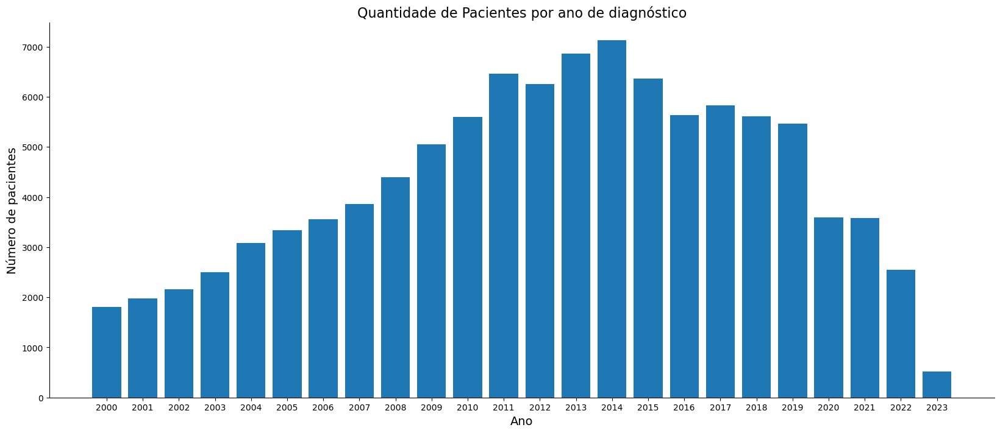

In [17]:
plt.figure(figsize=(20, 8))
plt.bar(height = data.ANODIAG.value_counts().sort_index(), x=np.sort(data.ANODIAG.unique()))
plt.xlabel('Ano', size=14)
plt.xticks(np.sort(data.ANODIAG.unique()))
plt.ylabel('Número de pacientes', size=14)
plt.title('Quantidade de Pacientes por ano de diagnóstico', size=16)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.show()

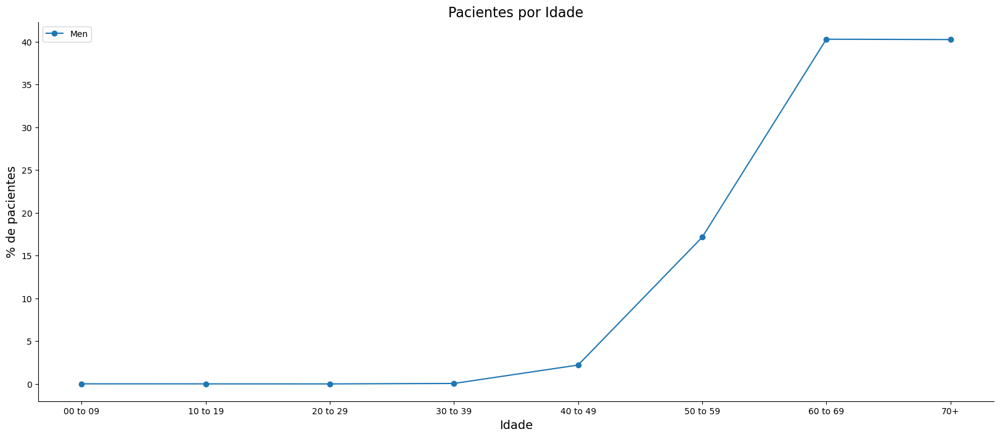

In [18]:
# Substituindo o formato de string para a coluna de faixa etária
before = ['00-09', '10-19', '20-29', '30-39', '40-49', '50-59', '60-69','70+']
after = ['00 to 09', '10 to 19', '20 to 29', '30 to 39', '40 to 49', '50 to 59', '60 to 69','70+']

# Atribuindo a substituição diretamente à coluna
data['FAIXAETAR'] = data['FAIXAETAR'].replace(before, after)

# Preparando os dados para o gráfico
faixas_etarias = np.sort(data['FAIXAETAR'].unique())  # Obtendo faixas etárias únicas ordenadas
contagem_faixas = data['FAIXAETAR'].value_counts().sort_index()  # Contagem por faixa etária, ordenado

# Plotando o gráfico apenas para os homens, uma vez que a coluna já é específica para esse grupo
fig, ax = plt.subplots(figsize=(20, 8))
ax1 = ax.plot(faixas_etarias, (contagem_faixas/data.shape[0])*100, label='Men', marker='o')

# Configurando os rótulos e o título
ax.set_xlabel('Idade', size=14)
ax.set_ylabel('% de pacientes', size=14)
ax.set_title('Pacientes por Idade', size=16)

# Configuração do gráfico
ax.legend()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.show()

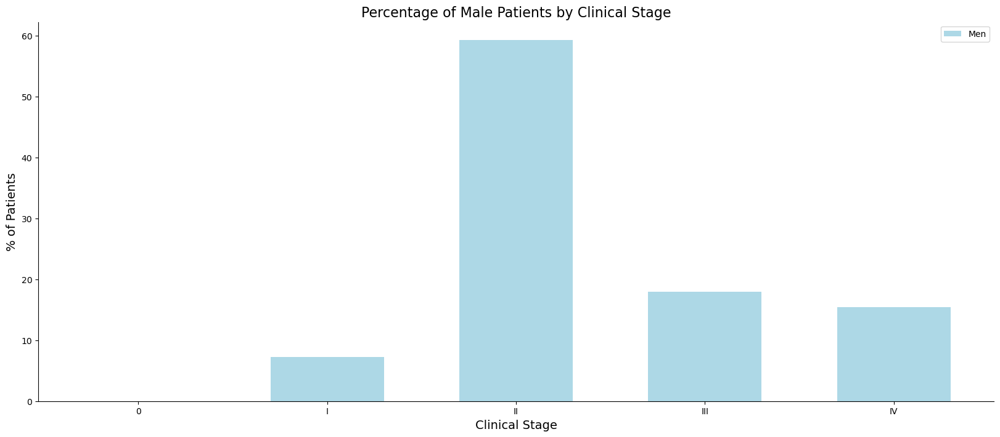

In [19]:
# Definindo as primeiras 5 categorias clínicas (excluindo X e Y)
EC = list(np.sort(data['ECGRUP'].unique()))[:5]  # Considera apenas as categorias 0, I, II, III, IV

# Filtrando o DataFrame `data` para incluir apenas essas categorias clínicas
data_filtered = data.loc[data['ECGRUP'].isin(EC)]

# Preparando os dados para o gráfico
clinical_stages = np.sort(data_filtered['ECGRUP'].unique())  # Categorias clínicas únicas e ordenadas
counts_stages = data_filtered['ECGRUP'].value_counts().sort_index()  # Contagem por categoria clínica

# Definindo as posições para as categorias no eixo x
x = np.arange(len(clinical_stages))

# Criando o gráfico de barras apenas para os homens
fig, ax = plt.subplots(figsize=(20, 8))
width = 0.6  # Largura das barras

# Plotando as barras com a porcentagem de pacientes em cada estágio clínico
ax1 = ax.bar(x, (counts_stages / data_filtered.shape[0]) * 100, width, label='Men', color='lightblue')

# Configurando os rótulos e o título
ax.set_xlabel('Clinical Stage', size=14)
ax.set_ylabel('% of Patients', size=14)
ax.set_title('Percentage of Male Patients by Clinical Stage', size=16)

# Configuração dos rótulos no eixo x
ax.set_xticks(x)
ax.set_xticklabels(list(clinical_stages))

# Removendo linhas de borda desnecessárias no gráfico
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Exibindo a legenda
ax.legend()

# Exibindo o gráfico
plt.show()


In [20]:
df_diag1 = data[data.DIAGPREV == 1] # without diagnosis/without treatment
df_diag2 = data[data.DIAGPREV == 2] # with diagnosis/without treatment

x = np.sort(df_diag1.ANODIAG.unique())
y = df_diag1.groupby('ANODIAG')['CONSDIAG'].median()

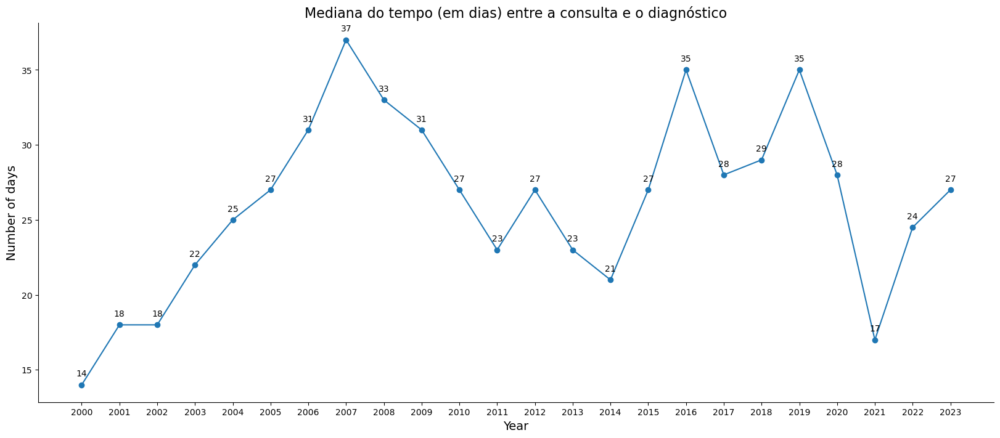

In [21]:
plt.figure(figsize=(20, 8))
plt.plot(x, y, marker='o')
plt.xlabel('Year', size=14)
plt.xticks(x)
plt.ylabel('Number of days', size=14)
plt.title('Mediana do tempo (em dias) entre a consulta e o diagnóstico', size=16)
for xi, yi in zip(x,y):
    label = '{:.0f}'.format(yi)
    plt.annotate(label, # this is the text
                 (xi, yi), # this is the point to label
                 textcoords='offset points', # how to position the text
                 xytext=(0, 10), # distance from text to points (x,y)
                 ha='center') # horizontal alignment can be left, right or center
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.show()

In [22]:
# 1 – Alive with cancer; 2 – Alive, without other specifications;
# 3 – Death by cancer; 4 – Death by other causes, without other specifications
data['ULTINFO'].value_counts()

ULTINFO
2    48052
1    19917
4    19041
3    16188
Name: count, dtype: int64

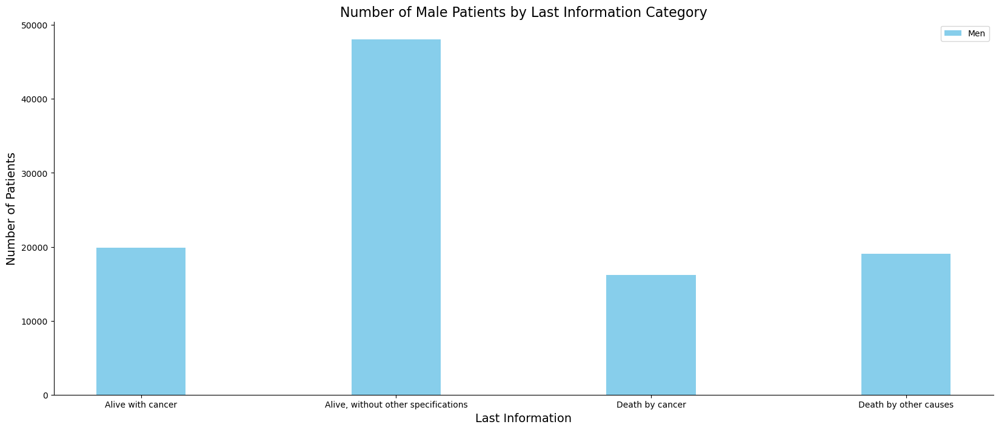

In [23]:
# Obtendo as categorias únicas e suas contagens apenas para homens
mascx = np.sort(data.ULTINFO.unique())
mascy = data.ULTINFO.value_counts().sort_index()

# Definindo as categorias de rótulos no eixo x
x_ticks = ['Alive with cancer', 'Alive, without other specifications', 'Death by cancer', 'Death by other causes']

# Criando o gráfico de barras apenas para homens
x = np.arange(len(x_ticks))  # Posições das categorias no eixo x
fig, ax = plt.subplots(figsize=(20, 8))
width = 0.35  # Largura das barras

# Plotando as barras para homens
ax1 = ax.bar(x, mascy, width, label='Men', color='skyblue')

# Configurando os rótulos e o título do gráfico
ax.set_xlabel('Last Information', size=14)
ax.set_ylabel('Number of Patients', size=14)
ax.set_title('Number of Male Patients by Last Information Category', size=16)

# Configuração do gráfico
ax.legend()
ax.set_xticks(x)
ax.set_xticklabels(list(x_ticks))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.show()


In [24]:
data.drop(columns=['S',
                     'QUIMIOANT','HORMOANT','TMOANT','IMUNOANT','OUTROANT',
                     'CICI','CICIGRUP','CICISUBGRU',
                   ], inplace=True)

In [25]:
data_numeric = data.select_dtypes(include='number')
corr_matrix =data_numeric.corr()
abs(corr_matrix['ULTINFO']).sort_values(ascending = False)

ULTINFO       1.000000
ANODIAG       0.402533
GLEASON       0.291980
PSA           0.278197
CATEATEND     0.276219
PERDASEG      0.261136
IDADE         0.210338
ESCOLARI      0.143846
DIAGPREV      0.138810
HORMONIO      0.099780
NENHUMAPOS    0.085782
RADIOAPOS     0.085421
DIAGTRAT      0.083088
OUTROAPOS     0.073469
IBGEATEN      0.070665
CONSDIAG      0.063720
G             0.062755
QUIMIO        0.054758
RECREGIO      0.047681
RRAS          0.045688
HORMOAPOS     0.043807
OUTROS        0.039951
CIRURGIA      0.036194
HABILIT2      0.035710
NAOTRAT       0.031961
NENHUM        0.030708
RECDIST       0.029778
RECLOCAL      0.028503
CIRURAPOS     0.027826
QUIMIOAPOS    0.024622
NENHUMANT     0.019749
RADIO         0.019233
IMUNO         0.013881
CLINICA       0.012200
HABILIT       0.010300
CIDO          0.006611
MORFO         0.006611
RECNENHUM     0.006497
IBGE          0.005730
HABILIT1      0.004657
IMUNOAPOS     0.003709
BASEDIAG      0.002965
TRATCONS      0.001272
TMO        

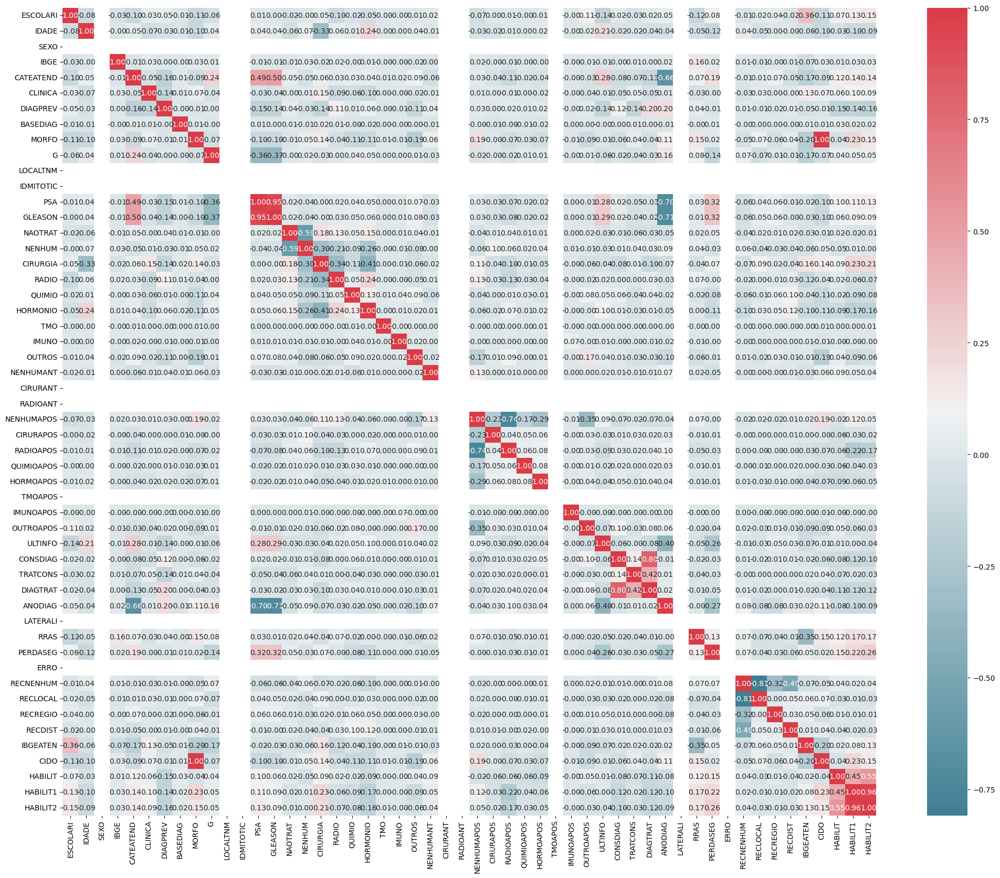

In [26]:
fig, ax = plt.subplots(figsize = (25, 20))
colormap = sns.diverging_palette(220, 10, as_cmap = True)
 
sns.heatmap(corr_matrix, cmap = colormap, annot = True, fmt = '.2f')
plt.show()

In [27]:
data.drop(columns=['SEXO','IDMITOTIC','LOCALTNM','CIRURANT','RADIOANT','LATERALI','ERRO','TMOAPOS'    
                    ], inplace=True)

In [28]:
data_numeric = data.select_dtypes(include='number')

# Calcular a matriz de correlação
corr_matrix = data_numeric.corr()
abs(corr_matrix['ULTINFO']).sort_values(ascending = False)

ULTINFO       1.000000
ANODIAG       0.402533
GLEASON       0.291980
PSA           0.278197
CATEATEND     0.276219
PERDASEG      0.261136
IDADE         0.210338
ESCOLARI      0.143846
DIAGPREV      0.138810
HORMONIO      0.099780
NENHUMAPOS    0.085782
RADIOAPOS     0.085421
DIAGTRAT      0.083088
OUTROAPOS     0.073469
IBGEATEN      0.070665
CONSDIAG      0.063720
G             0.062755
QUIMIO        0.054758
RECREGIO      0.047681
RRAS          0.045688
HORMOAPOS     0.043807
OUTROS        0.039951
CIRURGIA      0.036194
HABILIT2      0.035710
NAOTRAT       0.031961
NENHUM        0.030708
RECDIST       0.029778
RECLOCAL      0.028503
CIRURAPOS     0.027826
QUIMIOAPOS    0.024622
NENHUMANT     0.019749
RADIO         0.019233
IMUNO         0.013881
CLINICA       0.012200
HABILIT       0.010300
CIDO          0.006611
MORFO         0.006611
RECNENHUM     0.006497
IBGE          0.005730
HABILIT1      0.004657
IMUNOAPOS     0.003709
BASEDIAG      0.002965
TRATCONS      0.001272
TMO        

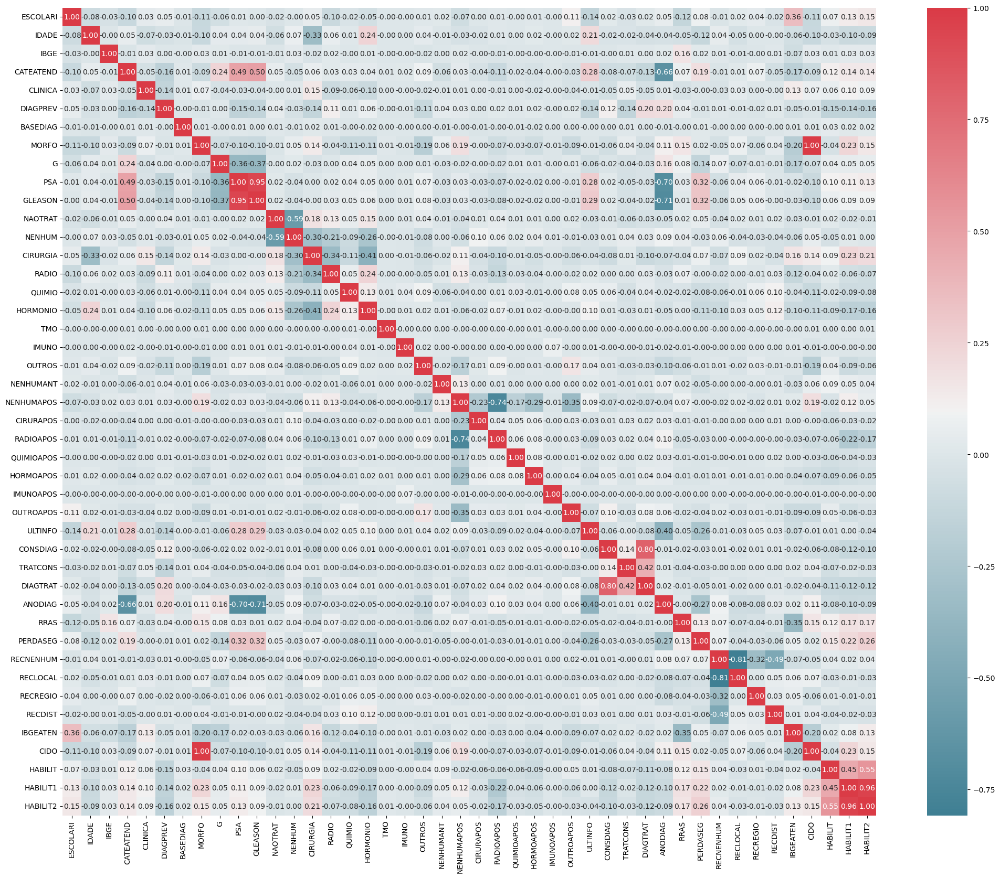

In [29]:
fig, ax = plt.subplots(figsize = (25, 20))
colormap = sns.diverging_palette(220, 10, as_cmap = True)
 
sns.heatmap(corr_matrix, cmap = colormap, annot = True, fmt = '.2f')
plt.show()

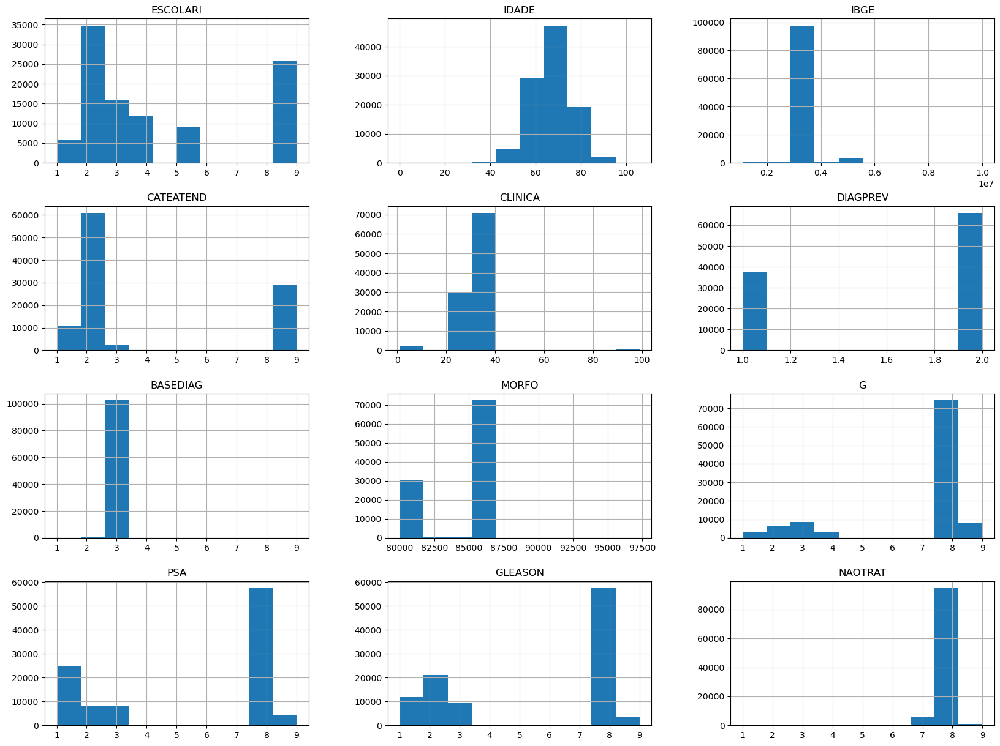

In [30]:
data.iloc[:,:38].hist(bins=10, figsize=(20, 15))
plt.show()

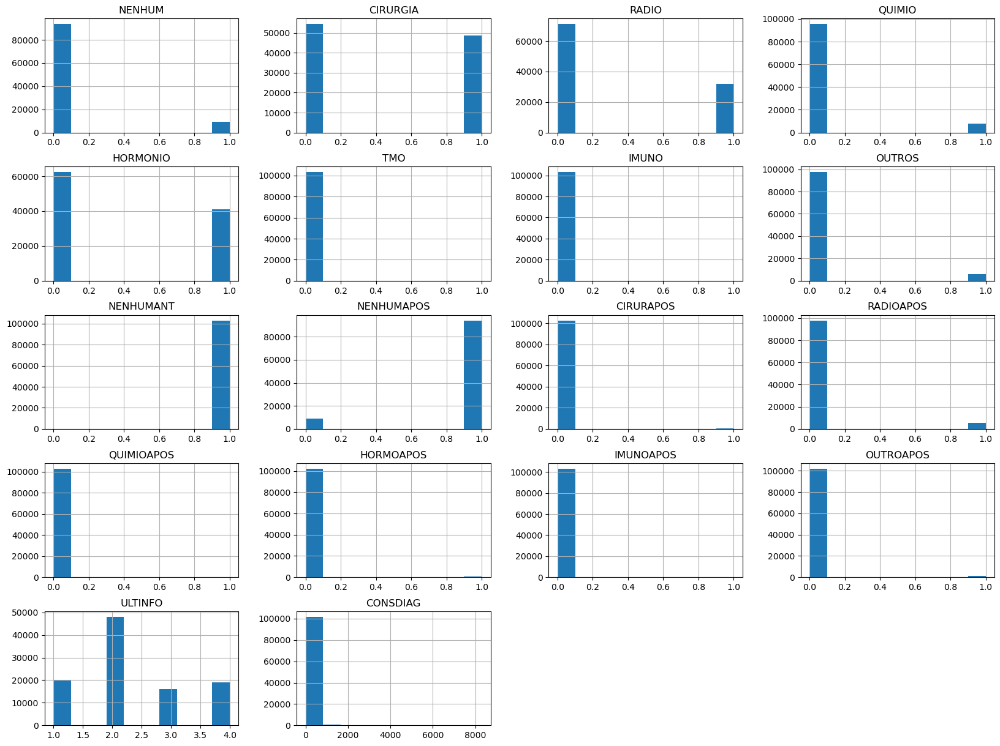

In [31]:
data.iloc[:,38:58].hist(bins=10, figsize=(20, 15))
plt.show()

# Valores Faltantes:

In [33]:
missing = data.isna().sum().sort_values(ascending=False)
prop = missing[missing > 0]/data.shape[0]
prop

REC04         0.999331
INSTORIG      0.999157
META04        0.998711
REC03         0.997326
META03        0.994787
REC02         0.986792
META02        0.974147
REC01         0.949011
OUTRACLA      0.905018
META01        0.894688
DTRECIDIVA    0.880695
PM            0.644925
PN            0.601078
PT            0.591087
DRS           0.088684
DTTRAT        0.080719
DIAGTRAT      0.080719
TRATCONS      0.080719
dtype: float64

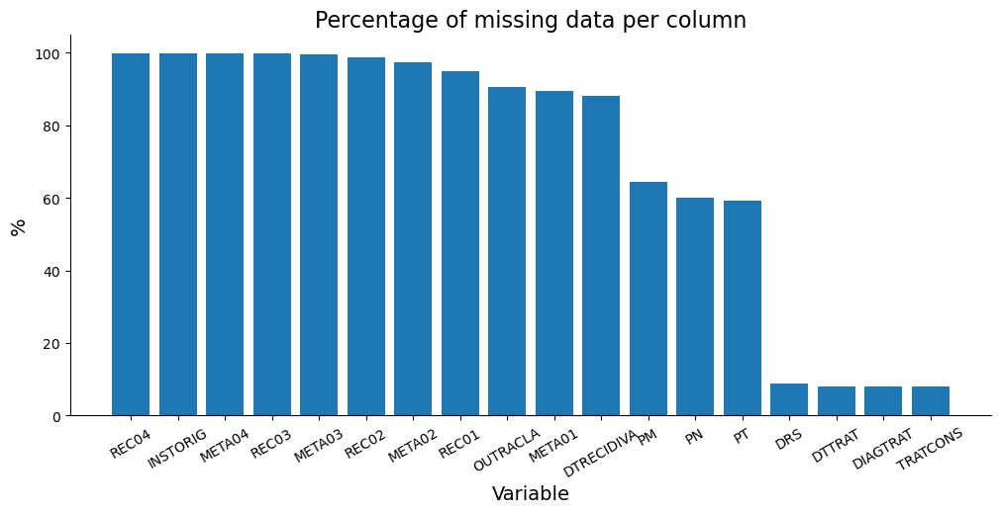

In [34]:
plt.figure(figsize=(12, 5))
plt.bar(height = prop*100, x=prop.index)
plt.xlabel('Variable', size=14)
plt.ylabel('%', size=14)
plt.title('Percentage of missing data per column', size=16)
plt.xticks(rotation=30)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.show()

In [35]:
# META04 - Metástase. Formato: C99
data[data['META02'].isna() == False]['META02'].shape

(2668,)

# Pré - Processamento

In [37]:

data.head(6)

,ESCOLARI,IDADE,UFNASC,UFRESID,IBGE,CIDADE,CATEATEND,DTCONSULT,CLINICA,DIAGPREV,...,REC03,REC04,IBGEATEN,CIDO,DSCCIDO,HABILIT,HABIT11,HABILIT1,HABILIT2,CIDADEH
0,9,72,TO,SP,3524402,JACAREI,2,10/4/2016,32,2,...,NaN,NaN,3524402,80001,NEOPLASIA DE COMPORTAMENTO INCERTO SE BENIGNO ...,1,UNACON,1,1,Jacarei
1,5,67,SP,SP,3533007,NOVA GRANADA,2,10/13/2019,32,1,...,NaN,NaN,3549805,80001,NEOPLASIA DE COMPORTAMENTO INCERTO SE BENIGNO ...,10,"UNACON com Serviþos de Radioterapia, de Hemato...",1,1,SÒo JosÚ do Rio Preto
2,2,97,SP,SP,3555406,UBATUBA,2,2/13/2009,24,2,...,NaN,NaN,3524402,80003,NEOPLASIA MALIGNA,1,UNACON,1,1,Jacarei
3,2,74,SP,SP,3524402,JACAREI,2,12/20/2013,24,2,...,NaN,NaN,3524402,80003,NEOPLASIA MALIGNA,1,UNACON,1,1,Jacarei
4,9,58,SP,SP,3524402,JACAREI,2,5/21/2014,24,2,...,NaN,NaN,3524402,80003,NEOPLASIA MALIGNA,1,UNACON,1,1,Jacarei
5,9,64,SP,SP,3524402,JACAREI,2,12/12/2017,24,2,...,NaN,NaN,3524402,80003,NEOPLASIA MALIGNA,1,UNACON,1,1,Jacarei


In [38]:

    # Excluindo valores em ECGRUP que possuem X e Y , pois são irrelevantes
    data = data[~data.ECGRUP.isin(['X','Y'])]

    # Selecionamos apenas a morfologia 85503
    data = data[data.MORFO == 85503]
    # Colunas CIDO e DSCCIDO, possuem descrições desta morfologia e todas vão possuir os mesmo valores, logo são irrelevantes.
    data.drop(columns=['CIDO', 'DSCCIDO'],inplace=True)
    # DRS
    DRS_expand = data.DRS.str.split(' ', expand=True)
    data['DRS'] = DRS_expand[1]
    data.DRS.fillna(0)

    data = data[data.UFRESID == 'SP']
    data.drop(columns=['UFRESID', 'UFNASC', 'CIDADE', 'DESCTOPO', 'DESCMORFO',
                 'META01', 'META02', 'REC01', 'REC02', 'REC03',
                 'MORFO',  'TOPO', 'TOPOGRUP', 'T', 
                 'N', 'M', 'NAOTRAT', 'TRATAMENTO', 'TRATFAPOS', 'NENHUMAPOS', 
                 'CIRURAPOS', 'RADIOAPOS', 'QUIMIOAPOS', 'HORMOAPOS', 'IMUNOAPOS',
                 'OUTROAPOS', 'RECLOCAL', 'RECREGIO', 'RECDIST', 'HABILIT', 'META03', 'META04', 'REC04', 'PSA','GLEASON','G', #Removidos Gleason, G e PSA
                 'INSTORIG', 'OUTRACLA' , 'PM', 'PN', 'PT'], inplace=True)


In [39]:
data.shape

(61681, 40)

In [40]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 61681 entries, 30828 to 103109
Data columns (total 40 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   ESCOLARI    61681 non-null  int64  
 1   IDADE       61681 non-null  int64  
 2   IBGE        61681 non-null  int64  
 3   CATEATEND   61681 non-null  int64  
 4   DTCONSULT   61681 non-null  object 
 5   CLINICA     61681 non-null  int64  
 6   DIAGPREV    61681 non-null  int64  
 7   DTDIAG      61681 non-null  object 
 8   BASEDIAG    61681 non-null  int64  
 9   EC          61681 non-null  object 
 10  ECGRUP      61681 non-null  object 
 11  DTTRAT      56874 non-null  object 
 12  TRATHOSP    61681 non-null  object 
 13  TRATFANTES  61681 non-null  object 
 14  NENHUM      61681 non-null  int64  
 15  CIRURGIA    61681 non-null  int64  
 16  RADIO       61681 non-null  int64  
 17  QUIMIO      61681 non-null  int64  
 18  HORMONIO    61681 non-null  int64  
 19  TMO         61681 non-nul

In [41]:
data.to_csv('data_preProcess1.csv', index=False)

# Criação de colunas

In [43]:
df = pd.read_csv('data_preProcess1.csv', sep = ',', encoding = 'UTF-8',low_memory=False)

In [44]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61681 entries, 0 to 61680
Data columns (total 40 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   ESCOLARI    61681 non-null  int64  
 1   IDADE       61681 non-null  int64  
 2   IBGE        61681 non-null  int64  
 3   CATEATEND   61681 non-null  int64  
 4   DTCONSULT   61681 non-null  object 
 5   CLINICA     61681 non-null  int64  
 6   DIAGPREV    61681 non-null  int64  
 7   DTDIAG      61681 non-null  object 
 8   BASEDIAG    61681 non-null  int64  
 9   EC          61681 non-null  object 
 10  ECGRUP      61681 non-null  object 
 11  DTTRAT      56874 non-null  object 
 12  TRATHOSP    61681 non-null  object 
 13  TRATFANTES  61681 non-null  object 
 14  NENHUM      61681 non-null  int64  
 15  CIRURGIA    61681 non-null  int64  
 16  RADIO       61681 non-null  int64  
 17  QUIMIO      61681 non-null  int64  
 18  HORMONIO    61681 non-null  int64  
 19  TMO         61681 non-nul

In [45]:
# NULL! to NaN
df.loc[df.DTRECIDIVA == '#NULL!', 'DTRECIDIVA'] = np.nan
df.loc[df.DTTRAT == '#NULL!', 'DTTRAT'] = np.nan
df.loc[df.DTULTINFO == '#NULL!', 'DTULTINFO'] = np.nan

In [46]:
# Dates - DTCONSULT, DTDIAG, DTTRAT, DTULTINFO, DTRECIDIVA
lista_datas = ['DTCONSULT', 'DTDIAG', 'DTTRAT', 'DTULTINFO', 'DTRECIDIVA']
df[lista_datas].isna().sum()

DTCONSULT         0
DTDIAG            0
DTTRAT         4807
DTULTINFO         0
DTRECIDIVA    53026
dtype: int64

In [47]:
df[lista_datas].head(10)

,DTCONSULT,DTDIAG,DTTRAT,DTULTINFO,DTRECIDIVA
0,12/12/2017,11/20/2017,12/12/2017,11/17/2023,NaN
1,5/13/2015,3/26/2015,NaN,10/2/2017,NaN
2,1/26/2015,12/13/2014,NaN,12/18/2017,NaN
3,4/9/2015,2/12/2015,NaN,11/8/2018,NaN
4,10/4/2000,10/4/2000,11/6/2000,10/22/2003,NaN
5,10/11/2001,1/24/2002,2/19/2002,4/29/2003,1/9/2003
6,10/11/2002,10/11/2002,10/16/2002,6/14/2015,NaN
7,2/5/2003,2/5/2003,2/6/2003,2/28/2019,NaN
8,10/16/2003,10/16/2003,11/14/2003,10/9/2015,NaN
9,12/15/2003,12/15/2003,12/15/2003,1/3/2019,NaN


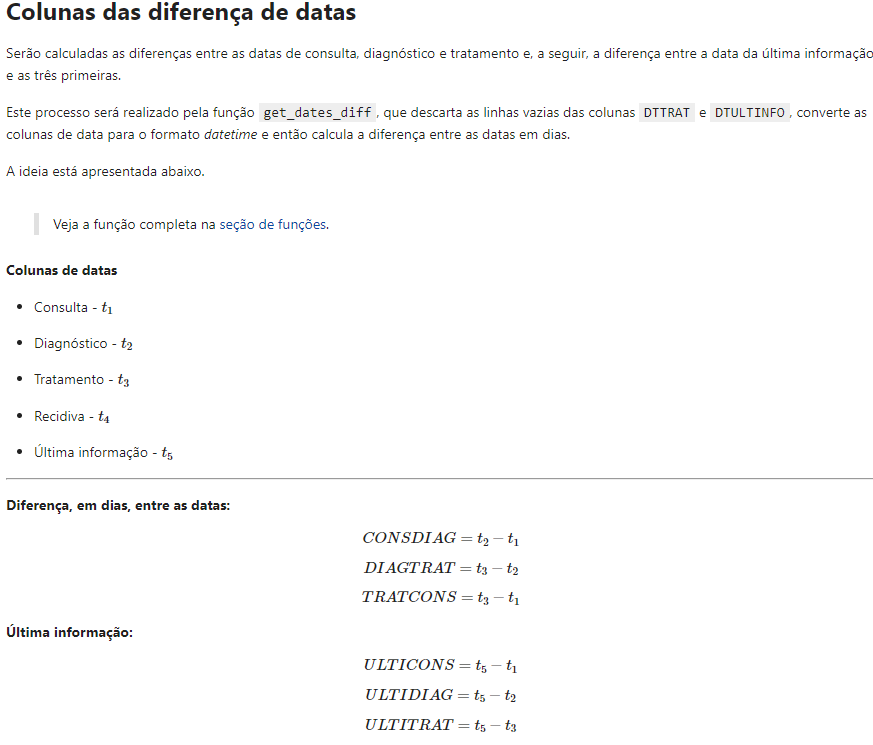

In [49]:
dates = ['CONSDIAG', 'DIAGTRAT', 'TRATCONS', 'ULTICONS', 'ULTIDIAG', 'ULTITRAT']

In [50]:
def get_dates_diff(df, dates_list):
    """Get the difference, in days, between columns with dates.

    :param df: pd.DataFrame: DataFrame to get the dates difference.
    :param dates_list: list: List with the name of date columns.

    :return: DataFrame with dates difference in nine new columns.
    :rtype: pd.DataFrame
    """
    
    df_aux = df.copy()
    
    df_aux.dropna(subset=['DTTRAT', 'DTULTINFO'], inplace=True)
    
    for c in dates_list:
        fmt = '%m/%d/%Y' if c in ['DTTRAT', 'DTULTINFO', 'DTRECIDIVA'] else '%m/%d/%Y'
        df_aux[c] = pd.to_datetime(df_aux[c], errors='coerce', format=fmt)
        
    df_aux['CONSDIAG'] = (df_aux.DTDIAG - df_aux.DTCONSULT).dt.days
    df_aux['DIAGTRAT'] = (df_aux.DTTRAT - df_aux.DTDIAG).dt.days
    df_aux['TRATCONS'] = (df_aux.DTTRAT - df_aux.DTCONSULT).dt.days

    # df_aux['RECCONS'] = (df_aux.DTRECIDIVA - df_aux.DTCONSULT).dt.days
    # df_aux['RECDIAG'] = (df_aux.DTRECIDIVA - df_aux.DTDIAG).dt.days
    # df_aux['RECTRAT'] = (df_aux.DTRECIDIVA - df_aux.DTTRAT).dt.days

    df_aux['ULTICONS'] = (df_aux.DTULTINFO - df_aux.DTCONSULT).dt.days
    df_aux['ULTIDIAG'] = (df_aux.DTULTINFO - df_aux.DTDIAG).dt.days
    df_aux['ULTITRAT'] = (df_aux.DTULTINFO - df_aux.DTTRAT).dt.days

    df_aux.drop(columns=['DTCONSULT', 'DTDIAG', 'DTTRAT', 'DTRECIDIVA', 'DTULTINFO'],
                inplace=True)

    return df_aux

In [51]:
df = get_dates_diff(df, lista_datas)
print(df.shape)

(56874, 38)


In [52]:
df[dates].head(10)

,CONSDIAG,DIAGTRAT,TRATCONS,ULTICONS,ULTIDIAG,ULTITRAT
0,-22,22,0,2166,2188,2166
4,0,33,33,1113,1113,1080
5,105,26,131,565,460,434
6,0,5,5,4629,4629,4624
7,0,1,1,5867,5867,5866
8,0,29,29,4376,4376,4347
9,0,0,0,5498,5498,5498
10,0,0,0,4209,4209,4209
11,0,100,100,2350,2350,2250
12,-76,99,23,3136,3212,3113


# Histogramas a respeito das novas colunas criadas

In [54]:
fig = px.histogram(df, x='CONSDIAG', marginal='box',
                   title='Diferença de dias entre diagnóstico e consulta')
fig.show(config = {'staticPlot': True})
     

fig = px.histogram(df, x='DIAGTRAT', marginal='box',
                   title='Diferença de dias entre tratamento e diagnóstico')
fig.show(config = {'staticPlot': True})
     

fig = px.histogram(df, x='TRATCONS', marginal='box', 
                   title='Diferença de dias entre tratamento e consulta')
fig.show(config = {'staticPlot': True})
     

fig = px.histogram(df, x='ULTICONS', marginal='box',
                   title='Diferença de dias entre última informação e consulta')
fig.show(config = {'staticPlot': True})
     

fig = px.histogram(df, x='ULTIDIAG', marginal='box',
                   title='Diferença de dias entre última informação e diagnóstico')
fig.show(config = {'staticPlot': True})
     

fig = px.histogram(df, x='ULTITRAT', marginal='box', 
                   title='Diferença de dias entre última informação e tratamento')
fig.show(config = {'staticPlot': True})

# Coluna de óbito

In [56]:
def get_labels(df):
    """Create death labels acording to the last information year.

    :param df pd.DataFrame: dataframe to be processed.

    :return: DataFrame with the new labels
    :rtype: pd.DataFrame
    """

    df_aux = df.copy()

    df_aux['obito_geral'] = 0
    df_aux['obito_cancer'] = 0

    df_aux['vivo_ano1'] = 0
    df_aux['vivo_ano3'] = 0
    df_aux['vivo_ano5'] = 0 
    
    df_aux.loc[df_aux.ULTINFO > 2, 'obito_geral'] = 1

    df_aux.loc[df_aux.ULTINFO == 3, 'obito_cancer'] = 1

    df_aux.loc[df_aux.ULTIDIAG > 365, 'vivo_ano1'] = 1
    df_aux.loc[df_aux.ULTIDIAG > 3*365, 'vivo_ano3'] = 1
    df_aux.loc[df_aux.ULTIDIAG > 5*365, 'vivo_ano5'] = 1

    return df_aux

In [57]:
df.head(2)

,ESCOLARI,IDADE,IBGE,CATEATEND,CLINICA,DIAGPREV,BASEDIAG,EC,ECGRUP,TRATHOSP,...,PERDASEG,RECNENHUM,IBGEATEN,HABIT11,HABILIT1,HABILIT2,CIDADEH,ULTICONS,ULTIDIAG,ULTITRAT
0,1,0,3536703,2,32,2,3,I,I,J,...,0,1,3506003,"UNACON com Serviþos de Radioterapia, de Hemato...",1,1,Bauru,2166,2188,2166
4,2,71,3546207,9,24,2,3,II,II,B,...,0,1,3538709,UNACON com Serviþos de Radioterapia e de Hemat...,1,1,Piracicaba,1113,1113,1080


In [58]:
df.ULTINFO.value_counts()


ULTINFO
2    29452
4    10650
1     9102
3     7670
Name: count, dtype: int64

Última informação[Ultinfo]

1 - Vivo com câncer

2 - Vivo, sem outras informações

3 - Óbito por câncer

4 - Óbitos por outras causas

In [60]:
df.shape

(56874, 38)

In [61]:
df = get_labels(df)
df.shape

(56874, 43)

In [62]:
columns = ['ULTINFO', 'obito_geral', 'obito_cancer', 'vivo_ano1', 'vivo_ano3', 'vivo_ano5']

df[columns].head(2)

,ULTINFO,obito_geral,obito_cancer,vivo_ano1,vivo_ano3,vivo_ano5
0,2,0,0,1,1,1
4,4,1,0,1,1,0


In [63]:
df[columns][df.ULTINFO == 1].head(10)

,ULTINFO,obito_geral,obito_cancer,vivo_ano1,vivo_ano3,vivo_ano5
79,1,0,0,1,1,1
104,1,0,0,1,1,1
142,1,0,0,1,1,1
346,1,0,0,0,0,0
354,1,0,0,0,0,0
357,1,0,0,0,0,0
359,1,0,0,0,0,0
360,1,0,0,0,0,0
361,1,0,0,0,0,0
362,1,0,0,0,0,0


In [64]:
df[columns][df.obito_geral == 0].head(10)


,ULTINFO,obito_geral,obito_cancer,vivo_ano1,vivo_ano3,vivo_ano5
0,2,0,0,1,1,1
7,2,0,0,1,1,1
9,2,0,0,1,1,1
21,2,0,0,1,1,1
33,2,0,0,1,1,1
35,2,0,0,1,1,1
42,2,0,0,1,1,1
47,2,0,0,1,1,1
48,2,0,0,1,1,1
49,2,0,0,1,1,1


# **Voltar para estimar valores NaN , caso preciso

In [66]:
#df.loc[df.ESCOLARI == 9, 'ESCOLARI'] = np.nan
df.loc[df.ECGRUP == 'I', 'ECGRUP'] = 1
df.loc[df.ECGRUP == 'II', 'ECGRUP'] = 2
df.loc[df.ECGRUP == 'III', 'ECGRUP'] = 3
df.loc[df.ECGRUP == 'IV', 'ECGRUP'] = 4
df.ESCOLARI.value_counts(dropna=False)

ESCOLARI
2    20756
9    12780
3     8038
4     7035
5     5454
1     2811
Name: count, dtype: int64

In [67]:
df = df.dropna(subset=['ESCOLARI'])


In [68]:
df.ESCOLARI.value_counts(dropna=False)

ESCOLARI
2    20756
9    12780
3     8038
4     7035
5     5454
1     2811
Name: count, dtype: int64

In [69]:
df.drop(columns=['CLINICA', 'ECGRUP','TRATFANTES','FAIXAETAR', 
                 'PERDASEG','HABIT11', 'HABILIT1','HABILIT2','CIDADEH','BASEDIAG','ESCOLARI' ], inplace=True) #removido também BASEDIAG POR NÃO SER RELEVANTE NA ANÁLISE

In [70]:
df.shape

(56874, 32)

In [71]:
data_numeric2 = df.select_dtypes(include='number')
corr_matrix =data_numeric2.corr()
abs(corr_matrix['ULTINFO']).sort_values(ascending = False)

ULTINFO         1.000000
obito_geral     0.884503
ANODIAG         0.381573
obito_cancer    0.267557
CATEATEND       0.266003
IDADE           0.211901
IBGEATEN        0.132923
DIAGPREV        0.121227
DRS             0.105740
HORMONIO        0.102348
DIAGTRAT        0.077417
RRAS            0.070169
QUIMIO          0.069673
IBGE            0.068558
CONSDIAG        0.066603
CIRURGIA        0.063668
NENHUM          0.061830
vivo_ano1       0.053372
OUTROS          0.039852
ULTITRAT        0.033936
vivo_ano3       0.031467
ULTICONS        0.031204
TRATCONS        0.023710
ULTIDIAG        0.022197
vivo_ano5       0.015446
RECNENHUM       0.014331
IMUNO           0.008678
RADIO           0.007867
TMO             0.002158
NENHUMANT            NaN
Name: ULTINFO, dtype: float64

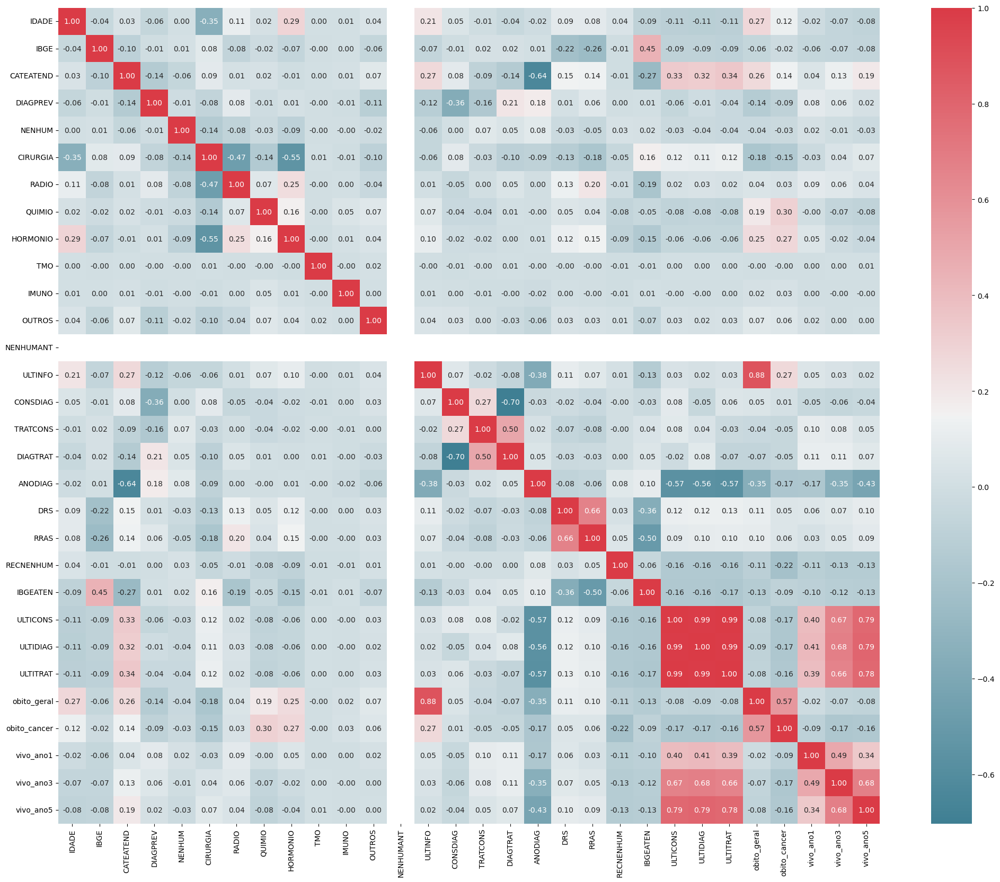

In [72]:
fig, ax = plt.subplots(figsize = (25, 20))
colormap = sns.diverging_palette(220, 10, as_cmap = True)
 
sns.heatmap(corr_matrix, cmap = colormap, annot = True, fmt = '.2f')
plt.show()

In [73]:
df.to_csv('data_preProcess2.csv', index=False)

# Criando Labels de Recurrence para São Paulo

In [75]:
def get_label_rec(df):
    """Create the labels analyzing whether there was recurrence.
    
    :param df pd.DataFrame: dataframe to be processed.

    :return: DataFrame with the new labels
    :rtype: pd.DataFrame
    """

    df_aux = df.copy()

    df_aux['ob_com_rec'] = 0
    df_aux['ob_sem_rec'] = 0
    df_aux['vivo_com_rec'] = 0
    df_aux['vivo_sem_rec'] = 0

    df_aux.loc[(df_aux.obito_geral == 1) & (df_aux.RECNENHUM == 1), 'ob_sem_rec'] = 1
    df_aux.loc[(df_aux.obito_geral == 1) & (df_aux.RECNENHUM == 0), 'ob_com_rec'] = 1
    df_aux.loc[(df_aux.obito_geral == 0) & (df_aux.RECNENHUM == 1), 'vivo_sem_rec'] = 1
    df_aux.loc[(df_aux.obito_geral == 0) & (df_aux.RECNENHUM == 0), 'vivo_com_rec'] = 1

    return df_aux

In [76]:
df_SP= pd.read_csv('data_preProcess2.csv', sep = ',', encoding = 'UTF-8',low_memory=False)

In [77]:
df_SP.shape

(56874, 32)

In [78]:
df_SP = get_label_rec(df_SP)

In [79]:
columns = ['RECNENHUM', 'obito_geral', 'obito_cancer', 'ob_com_rec', 'ob_sem_rec',
            'vivo_com_rec', 'vivo_sem_rec']
df_SP[columns].head()
     

,RECNENHUM,obito_geral,obito_cancer,ob_com_rec,ob_sem_rec,vivo_com_rec,vivo_sem_rec
0,1,0,0,0,0,0,1
1,1,1,0,0,1,0,0
2,0,1,1,1,0,0,0
3,1,1,0,0,1,0,0
4,1,0,0,0,0,0,1


In [80]:
df_SP.shape

(56874, 36)

# Verificando Dados

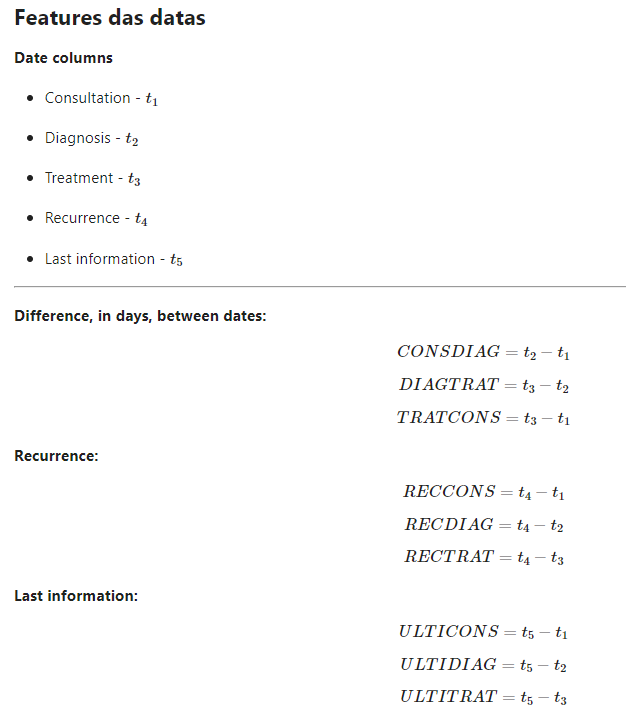

In [83]:
# Diagnóstico antes da consulta
df_SP[df_SP.CONSDIAG < 0].shape

(33414, 36)

In [84]:
# Tratamento antes do diagnóstico
df_SP[df_SP.DIAGTRAT < 0].shape

(0, 36)

In [85]:
# Tratamento antes da consulta
df_SP[df_SP.TRATCONS < 0].shape

(0, 36)

In [86]:
# Última informação antes da consulta
df_SP[df_SP.ULTICONS < 0].shape

(0, 36)

In [87]:
# Última informação antes do diagnóstico
df_SP[df_SP.ULTIDIAG < 0].shape

(0, 36)

In [88]:
df_SP[df_SP.ULTIDIAG > 365].shape

(51449, 36)

In [89]:
df_SP[df_SP.ULTIDIAG > 365*3].shape

(39663, 36)

In [90]:
df_SP[df_SP.ULTIDIAG > 365*5].shape

(29363, 36)

In [91]:
# Última informação antes do tratamento
df_SP[df_SP.ULTITRAT < 0].shape

(101, 36)

**Labels óbito**

* Óbito em qualquer momento - ob
* Patient is alive after one year - vivo_ano1;
* Patient is alive after three years - vivo_ano3;
* Patient is alive after five years - vivo_ano5;



In [93]:
df_SP.obito_geral.value_counts()


obito_geral
0    38554
1    18320
Name: count, dtype: int64

In [94]:
df_SP.obito_cancer.value_counts()


obito_cancer
0    49204
1     7670
Name: count, dtype: int64

In [95]:
df_SP.vivo_ano1.value_counts()


vivo_ano1
1    51449
0     5425
Name: count, dtype: int64

In [96]:
df_SP.vivo_ano3.value_counts()


vivo_ano3
1    39663
0    17211
Name: count, dtype: int64

In [97]:
df_SP.vivo_ano5.value_counts()


vivo_ano5
1    29363
0    27511
Name: count, dtype: int64

In [98]:
df_SP[(df_SP.obito_geral == 0) & (df_SP.vivo_ano1 == 0) & (df_SP.vivo_ano3 == 0) & (df_SP.vivo_ano5 == 0)].shape


(3515, 36)

In [99]:
df_SP[(df_SP.obito_geral == 0) & (df_SP.vivo_ano1 == 1) & (df_SP.vivo_ano3 == 0) & (df_SP.vivo_ano5 == 0)].shape


(7271, 36)

In [100]:
df_SP[(df_SP.obito_geral == 0) & (df_SP.vivo_ano1 == 1) & (df_SP.vivo_ano3 == 1) & (df_SP.vivo_ano5 == 0)].shape


(6756, 36)

In [101]:
df_SP.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 56874 entries, 0 to 56873
Data columns (total 36 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   IDADE         56874 non-null  int64 
 1   IBGE          56874 non-null  int64 
 2   CATEATEND     56874 non-null  int64 
 3   DIAGPREV      56874 non-null  int64 
 4   EC            56874 non-null  object
 5   TRATHOSP      56874 non-null  object
 6   NENHUM        56874 non-null  int64 
 7   CIRURGIA      56874 non-null  int64 
 8   RADIO         56874 non-null  int64 
 9   QUIMIO        56874 non-null  int64 
 10  HORMONIO      56874 non-null  int64 
 11  TMO           56874 non-null  int64 
 12  IMUNO         56874 non-null  int64 
 13  OUTROS        56874 non-null  int64 
 14  NENHUMANT     56874 non-null  int64 
 15  ULTINFO       56874 non-null  int64 
 16  CONSDIAG      56874 non-null  int64 
 17  TRATCONS      56874 non-null  int64 
 18  DIAGTRAT      56874 non-null  int64 
 19  ANOD

In [102]:
df['RRAS'].value_counts()


RRAS
6     14817
13     7308
9      6206
12     4616
15     3066
8      2660
5      2486
1      2436
10     2394
2      2134
16     1761
7      1563
4      1389
17     1379
14     1234
11     1081
3       344
Name: count, dtype: int64

In [103]:
df['DRS'].value_counts()

DRS
1     23606
6      6206
7      3752
15     3228
13     2900
16     2660
9      2394
5      1865
3      1835
17     1379
2      1348
4      1262
10     1234
11     1117
14     1075
8       712
12      301
Name: count, dtype: int64

In [104]:
df_SP.ob_sem_rec.value_counts()

ob_sem_rec
0    41988
1    14886
Name: count, dtype: int64

In [105]:
df_SP.ob_com_rec.value_counts()



ob_com_rec
0    53440
1     3434
Name: count, dtype: int64

In [106]:
df_SP.vivo_sem_rec.value_counts()

vivo_sem_rec
1    34387
0    22487
Name: count, dtype: int64

In [107]:
df_SP.vivo_com_rec.value_counts()

vivo_com_rec
0    52707
1     4167
Name: count, dtype: int64

<h1>Informações</h1>

In [109]:
def percent_surv(df):
    """
    """
    df_aux = df.copy()
    df_aux['meses_trat'] = (df_aux['ULTITRAT']/30).round()
    df_aux = (df_aux.groupby(by=['meses_trat'])['obito_geral'].sum()/df_aux.shape[0]).reset_index()

    soma = 1
    val = df_aux['obito_geral'].values.copy()
    for i in range(df_aux.shape[0]):
        soma -= df_aux.obito_geral[i]
        val[i] = soma
        
    df_aux['perc'] = val

    return df_aux

In [110]:
df.head(3)

,IDADE,IBGE,CATEATEND,DIAGPREV,EC,TRATHOSP,NENHUM,CIRURGIA,RADIO,QUIMIO,...,RECNENHUM,IBGEATEN,ULTICONS,ULTIDIAG,ULTITRAT,obito_geral,obito_cancer,vivo_ano1,vivo_ano3,vivo_ano5
0,0,3536703,2,2,I,J,1,0,0,0,...,1,3506003,2166,2188,2166,0,0,1,1,1
4,71,3546207,9,2,II,B,0,0,1,0,...,1,3538709,1113,1113,1080,1,0,1,1,0
5,69,3526704,9,1,IV,B,0,0,1,0,...,0,3538709,565,460,434,1,1,1,0,0


In [111]:
df.obito_geral.value_counts(True)

obito_geral
0    0.677884
1    0.322116
Name: proportion, dtype: float64

In [112]:
df_surv = percent_surv(df)
df_surv.head(3)

,meses_trat,obito_geral,perc
0,-14.0,0.0,1.0
1,-12.0,0.0,1.0
2,-11.0,0.0,1.0


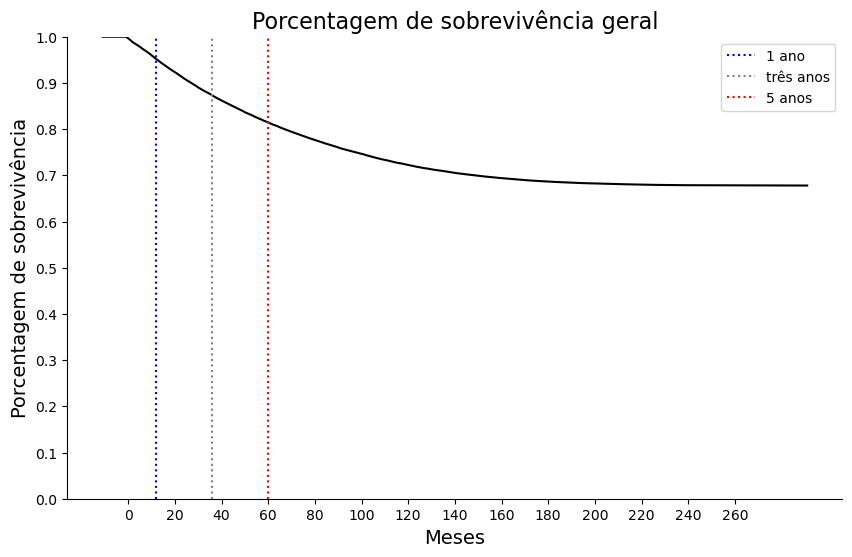

In [113]:
plt.figure(figsize=(10, 6))
plt.plot(df_surv.meses_trat[2:], df_surv.perc[2:], color='k')
plt.xlabel('Meses', size=14)
plt.xticks(np.linspace(0, 260, 14))
plt.yticks(np.linspace(0, 1, 11))
plt.ylabel('Porcentagem de sobrevivência', size=14)
plt.title('Porcentagem de sobrevivência geral', size=16)
plt.ylim([0, 1.])
plt.vlines(12, 0, 1, colors='b', label='1 ano', linestyle='dotted')
plt.vlines(36, 0, 1, colors='gray', label='três anos', linestyle='dotted')
plt.vlines(60, 0, 1, colors='r', label='5 anos', linestyle='dotted')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.legend()
plt.show()

In [114]:
fig = go.Figure(data=go.Scatter(x=df_surv.meses_trat[2:], y=df_surv.perc[2:]))
fig.show()

In [115]:
df.EC.unique()

array(['I', 'II', 'IV', 'III', 'IIA', 'IIB', 'IB', 'IIIA', 'IIIB', 'IA'],
      dtype=object)

In [116]:
df_1 = df.query("EC == 'I'")
df_surv1 = percent_surv(df_1)
df_surv1.head(3)

,meses_trat,obito_geral,perc
0,-8.0,0.0,1.0
1,-7.0,0.0,1.0
2,-3.0,0.0,1.0


In [117]:

df_2 = df.query("EC == 'II'")
df_surv2 = percent_surv(df_2)
df_surv2.head(3)

,meses_trat,obito_geral,perc
0,-12.0,0.0,1.0
1,-10.0,0.0,1.0
2,-1.0,0.0,1.0


In [118]:
df_3 = df.query("EC == 'III'")
df_surv3 = percent_surv(df_3)
df_surv3 = df_surv3.query("meses_trat >= 0")
df_surv3.head(3)

,meses_trat,obito_geral,perc
2,0.0,0.002310,0.997690
3,1.0,0.002310,0.995381
4,2.0,0.001829,0.993552


In [119]:
df_4 = df.query("EC == 'IV'")
df_surv4 = percent_surv(df_4)
df_surv4 = df_surv4.query("meses_trat >= 0")
df_surv4.head(3)

,meses_trat,obito_geral,perc
0,0.0,0.011672,0.988328
1,1.0,0.016170,0.972158
2,2.0,0.014347,0.957812


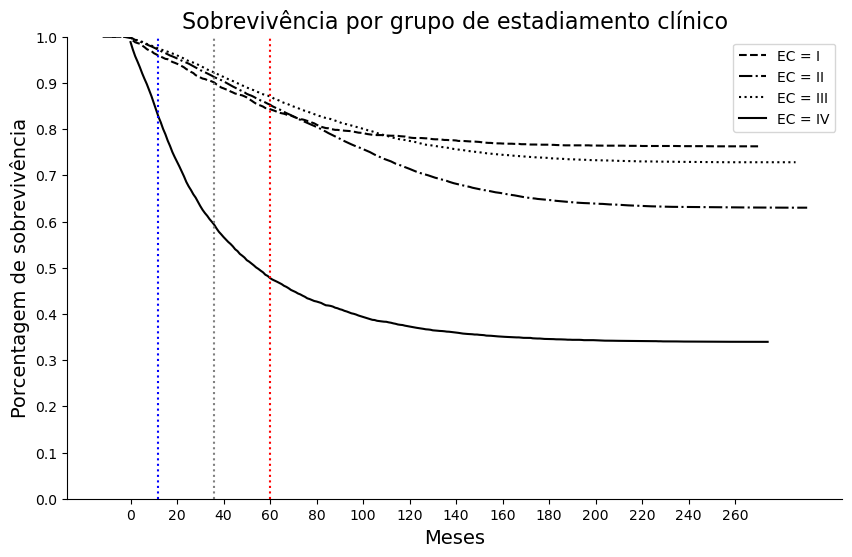

In [120]:
plt.figure(figsize=(10, 6))
plt.plot(df_surv1.meses_trat, df_surv1.perc, color='k', label='EC = I', linestyle='dashed')
plt.plot(df_surv2.meses_trat, df_surv2.perc, color='k', label='EC = II', linestyle='dashdot')
plt.plot(df_surv3.meses_trat, df_surv3.perc, color='k', label='EC = III', linestyle='dotted')
plt.plot(df_surv4.meses_trat, df_surv4.perc, color='k', label='EC = IV')

plt.xlabel('Meses', size=14)
plt.xticks(np.linspace(0, 260, 14))
plt.yticks(np.linspace(0, 1, 11))
plt.ylabel('Porcentagem de sobrevivência', size=14)
plt.title('Sobrevivência por grupo de estadiamento clínico', size=16)

plt.vlines(12, 0, 1, colors='b', #label='one year', 
           linestyle='dotted')
plt.vlines(36, 0, 1, colors='gray', #label='three years', 
           linestyle='dotted')
plt.vlines(60, 0, 1, colors='r', #label='five years', 
           linestyle='dotted')

plt.ylim([0, 1.])
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.legend()
plt.show()

In [121]:
def train_preprocessing(df, encoder_type='LabelEncoder', normalizer='StandardScaler',
                        pca=False, pca_components=None, random_state=0):
    """Preprocessing the train dataset.

    :param df pd.DataFrame: DataFrame to be preprocessed.
    :param encoder_type string: Encoder type to use for categorical features (default='LabelEncoder').
        options:
        * 'LabelEncoder'
        * 'OneHotEncoder'
    :param normalizer str: which normalizer to be fitted to the data (default='StandardScaler').
        options:
        * 'StandardScaler'
        * 'MinMaxScaler'
        * 'MaxAbsScaler'
        * 'QuantileTransformer'
    :param pca bool: if want to use PCA components set True (default=False).
    :param pca_components int: number of PCA components (default=None).
    :param random_state int: value for pca random_state (default=10).

    :return df: preprocessed train DataFrame 
    :rtype: pd.DataFrame
    :return enc: trained LabelEncoder 
    :rtype: dict
    :return norm: trained normalizer 
    :rtype: object
    :return pca if param pca=True: trained PCA 
    :rtype: object
    :return feat_cols: list with features names
    :rtype: list
    """

    df_aux = df.copy()

    list_categorical = df_aux.select_dtypes(include='object').columns

    enc = dict()
    if encoder_type == 'LabelEncoder':
        for col in list_categorical:
            enc[col] = LabelEncoder()
            df_aux[col] = enc[col].fit_transform(df_aux[col])

    elif encoder_type == 'OneHotEncoder':
        for col in list_categorical:
            enc[col] = OneHotEncoder(handle_unknown='ignore')
            ohe_results = enc[col].fit_transform(df_aux[[col]])
            df1 = pd.DataFrame(ohe_results.toarray(), columns=[f'{col}_{name}' for name in enc[col].categories_[0]], index=df_aux[col].index)
            df_aux = df_aux.merge(df1, how='left', left_index=True, right_index=True)

        df_aux.drop(columns=list_categorical, inplace=True)

    feat_cols = df_aux.columns

    if normalizer == 'StandardScaler':
        norm = StandardScaler()
    elif normalizer == 'MinMaxScaler':
        norm = MinMaxScaler((0, 1))
    elif normalizer == 'MaxAbsScaler':
        norm = MaxAbsScaler()
    elif normalizer == 'QuantileTransformer':
        norm = QuantileTransformer(output_distribution='normal')
    
    df_aux = norm.fit_transform(df_aux)

    if pca:
        pca = PCA(pca_components, random_state=random_state)
        df_aux = pca.fit_transform(df_aux)

        return df_aux, enc, norm, pca, feat_cols

    else:
        return df_aux, enc, norm, feat_cols
        
x_num, _, _, _ = train_preprocessing(df)

In [122]:
df_num = pd.DataFrame(x_num, columns=df.columns)
df_num.head(2)

,IDADE,IBGE,CATEATEND,DIAGPREV,EC,TRATHOSP,NENHUM,CIRURGIA,RADIO,QUIMIO,...,RECNENHUM,IBGEATEN,ULTICONS,ULTIDIAG,ULTITRAT,obito_geral,obito_cancer,vivo_ano1,vivo_ano3,vivo_ano5
0,-7.760827,0.176250,-0.522037,0.765045,-2.057086,1.409718,8.469292,-1.17544,-0.671549,-0.250257,...,0.392763,-1.716448,0.004651,-0.007464,0.079243,-0.689331,-0.394818,0.324722,0.658734,0.967950
1,0.530917,0.726764,1.752162,0.765045,-0.740882,-0.687381,-0.118074,-1.17544,1.489094,-0.250257,...,0.392763,0.185003,-0.648819,-0.676118,-0.596401,1.450681,-0.394818,0.324722,0.658734,-1.033111


<Axes: >

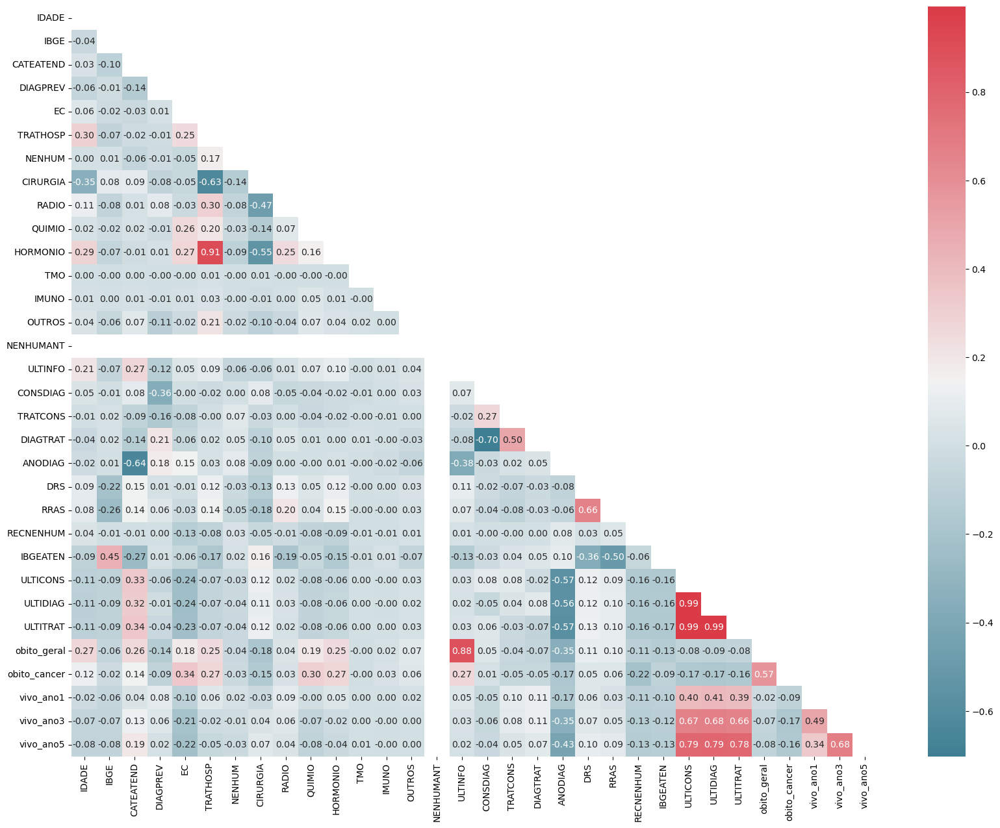

In [123]:
corr_matrix = df_num.corr()
fig, ax = plt.subplots(figsize = (20, 15))
colormap = sns.diverging_palette(220, 10, as_cmap = True)
mask = np.triu(np.ones_like(corr_matrix, dtype = bool))
sns.heatmap(corr_matrix, cmap = colormap, mask = mask, annot = True, fmt = '.2f')


In [124]:
feat = ['IDADE', 'IBGE', 'CATEATEND', 'DIAGPREV', 'EC', 'TRATHOSP', 
        'NENHUM', 'CIRURGIA', 'RADIO', 'QUIMIO',  'TMO', 'IMUNO',
        'OUTROS', 'NENHUMANT', 'CONSDIAG', 'TRATCONS', 'DIAGTRAT', 'ANODIAG',
        'DRS', 'RRAS',  'RECNENHUM', 'IBGEATEN', ]
        
len(feat)
     

22

In [125]:
df[feat].head(2)

,IDADE,IBGE,CATEATEND,DIAGPREV,EC,TRATHOSP,NENHUM,CIRURGIA,RADIO,QUIMIO,...,OUTROS,NENHUMANT,CONSDIAG,TRATCONS,DIAGTRAT,ANODIAG,DRS,RRAS,RECNENHUM,IBGEATEN
0,0,3536703,2,2,I,J,1,0,0,0,...,0,1,-22,0,22,2017,6,9,1,3506003
4,71,3546207,9,2,II,B,0,0,1,0,...,0,1,0,33,33,2000,10,14,1,3538709


In [126]:
x, _, _, _ = train_preprocessing(df[feat])

In [127]:
x.shape

(56874, 22)

In [128]:
%%capture

!pip install scipy -U

In [129]:
# 'obito_cancer', 'obito_geral', 'vivo_ano1', 'vivo_ano3', 'vivo_ano5'

In [130]:
#chi square tst vivo_ano5

from scipy.stats import chi2_contingency
for col in range(0, 25):
    chisqt = pd.crosstab(x[:, col], df['vivo_ano1'], margins=True)
    value = []

    for i in range(chisqt.shape[0] - 1):
        value.append(chisqt.iloc[i].values)

    print(f'{df[feat].columns[col]}: {chi2_contingency(np.array(value))[1]}') 


IDADE: 1.391145409421445e-09
IBGE: 4.676898553205517e-17
CATEATEND: 0.0
DIAGPREV: 2.428107833176427e-88
EC: 3.1030190614280608e-201
TRATHOSP: 2.4114409651021876e-77
NENHUM: 4.2752877704580375e-05
CIRURGIA: 1.5866019604368146e-11
RADIO: 2.720865874254256e-91
QUIMIO: 0.6150969189928623
TMO: 0.8999213265297853
IMUNO: 0.9184847347015528
OUTROS: 0.0003868725767146431
NENHUMANT: 1.0
CONSDIAG: 1.0
TRATCONS: 1.0
DIAGTRAT: 0.9875657333561452
ANODIAG: 0.0
DRS: 1.8730140821463093e-95
RRAS: 2.314371596338197e-120
RECNENHUM: 8.284565066627796e-156
IBGEATEN: 0.0


IndexError: index 22 is out of bounds for axis 1 with size 22

In [137]:
def variables_preprocessing2(df, dates_list):
    """Do some preprocessing on the DataFrame like strings splits, fill NaN values,
        replace values and drop some columns.

    :param df pd.DataFrame: DataFrame to be preprocessed.

    :return: DataFrame after be preprocessed and get some columns removed
    :rtype: pd.DataFrame
    """

    df_aux = df.copy()
    no_info = '**Sem informação**'

    # DRS
    DRS_expand = df_aux.DRS.str.split(' ', expand=True)
    df_aux['DRS'] = DRS_expand[1]
    df_aux.DRS.fillna('0', inplace=True)

    df_aux.dropna(subset=['DTTRAT', 'DTULTINFO'], inplace=True)

    for c in dates_list:
        fmt = '%m/%d/%Y' if c in ['DTTRAT', 'DTULTINFO', 'DTRECIDIVA'] else '%m/%d/%Y'
        df_aux[c] = pd.to_datetime(df_aux[c], errors='coerce', format=fmt)
        
    df_aux['CONSDIAG'] = (df_aux.DTDIAG - df_aux.DTCONSULT).dt.days
    df_aux['DIAGTRAT'] = (df_aux.DTTRAT - df_aux.DTDIAG).dt.days
    df_aux['TRATCONS'] = (df_aux.DTTRAT - df_aux.DTCONSULT).dt.days

    df_aux['ULTICONS'] = (df_aux.DTULTINFO - df_aux.DTCONSULT).dt.days
    df_aux['ULTIDIAG'] = (df_aux.DTULTINFO - df_aux.DTDIAG).dt.days
    df_aux['ULTITRAT'] = (df_aux.DTULTINFO - df_aux.DTTRAT).dt.days

    df_aux['obito_geral'] = 0
    df_aux['obito_cancer'] = 0

    df_aux['vivo_ano1'] = 0
    df_aux['vivo_ano3'] = 0
    df_aux['vivo_ano5'] = 0 
    
    df_aux.loc[df_aux.ULTINFO > 2, 'obito_geral'] = 1

    df_aux.loc[df_aux.ULTINFO == 3, 'obito_cancer'] = 1

    df_aux.loc[df_aux.ULTIDIAG > 365, 'vivo_ano1'] = 1
    df_aux.loc[df_aux.ULTIDIAG > 3*365, 'vivo_ano3'] = 1
    df_aux.loc[df_aux.ULTIDIAG > 5*365, 'vivo_ano5'] = 1

    col = df_aux.columns
    drop_cols = ['DTCONSULT', 'DTDIAG', 'DTTRAT', 'DTULTINFO', 
                 'DTRECIDIVA', 'DESCTOPO', 'DESCMORFO', 'CIDADE','UFRESID', 'UFNASC', 'CIDADE', 'DESCTOPO', 'DESCMORFO',
                 'META01', 'META02', 'REC01', 'REC02', 'REC03',
                 'MORFO',  'TOPO', 'TOPOGRUP', 'T', 
                 'N', 'M', 'NAOTRAT', 'TRATAMENTO', 'TRATFAPOS', 'NENHUMAPOS', 
                 'CIRURAPOS', 'RADIOAPOS', 'QUIMIOAPOS', 'HORMOAPOS', 'IMUNOAPOS',
                 'OUTROAPOS', 'RECLOCAL', 'RECREGIO', 'RECDIST', 'HABILIT', 'META03', 'META04', 'REC04', 
                 'INSTORIG', 'OUTRACLA' , 'PM', 'PN', 'PT']

    col = col.drop(drop_cols)

    return df_aux[col]

In [139]:
print(df.columns)

Index(['IDADE', 'IBGE', 'CATEATEND', 'DIAGPREV', 'EC', 'TRATHOSP', 'NENHUM',
       'CIRURGIA', 'RADIO', 'QUIMIO', 'HORMONIO', 'TMO', 'IMUNO', 'OUTROS',
       'NENHUMANT', 'ULTINFO', 'CONSDIAG', 'TRATCONS', 'DIAGTRAT', 'ANODIAG',
       'DRS', 'RRAS', 'RECNENHUM', 'IBGEATEN', 'ULTICONS', 'ULTIDIAG',
       'ULTITRAT', 'obito_geral', 'obito_cancer', 'vivo_ano1', 'vivo_ano3',
       'vivo_ano5'],
      dtype='object')


In [141]:
path = 'prostata_csv.csv'

def read_csv(path, drop_id=False):
    """"Read csv files

    :param path str: path to the csv file.

    :return: dataframe from the csv file.
    :rtype: pd.DataFrame
    """

    df = pd.read_csv(path, low_memory=False)
    
    #if drop_id:
       # df.drop(columns=['ID_estudo'], inplace=True)

    print(df.shape)

    return df

df_total = read_csv(path, drop_id=False)

# #NULL! to NaN
df_total.loc[df_total['DTRECIDIVA'] == '#NULL!', 'DTRECIDIVA'] = np.nan
df_total.loc[df_total['DTULTINFO'] == '#NULL!', 'DTULTINFO'] = np.nan
df_total.loc[df_total['DTTRAT'] == '#NULL!', 'DTTRAT'] = np.nan

df_limpo = variables_preprocessing2(df_total, ['DTCONSULT', 'DTDIAG', 'DTTRAT', 'DTULTINFO', 'DTRECIDIVA'])
df_limpo.head(2)
     

(103198, 100)


C:\Users\Alcir\AppData\Local\Temp\ipykernel_2940\2544461327.py:17: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





,ESCOLARI,IDADE,SEXO,IBGE,CATEATEND,CLINICA,DIAGPREV,BASEDIAG,EC,ECGRUP,...,HABILIT2,CIDADEH,ULTICONS,ULTIDIAG,ULTITRAT,obito_geral,obito_cancer,vivo_ano1,vivo_ano3,vivo_ano5
1,5,67,1,3533007,2,32,1,3,Y,Y,...,1,SÒo JosÚ do Rio Preto,215,213,213,0,0,0,0,0
2,2,97,1,3555406,2,24,2,3,Y,Y,...,1,Jacarei,747,804,730,1,0,1,0,0


<h1>Análise de Componentes Principais - PCA</h1>

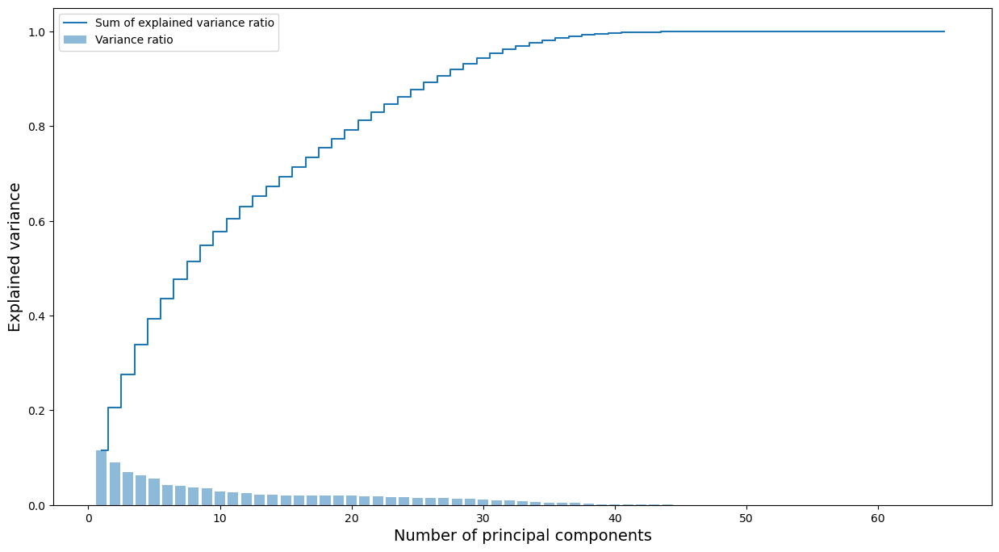

In [143]:
from sklearn.decomposition import PCA

x_tot, _, _, _ = train_preprocessing(df_limpo)

pca = PCA()
principalComponents = pca.fit_transform(x_tot)
     

plt.figure(figsize=(15, 8))

plt.bar(np.linspace(1, x_tot.shape[1], x_tot.shape[1]), 
        pca.explained_variance_ratio_, alpha=0.5, align='center', 
        label='Variance ratio')
plt.step(np.linspace(1, x_tot.shape[1], x_tot.shape[1]), 
         np.cumsum(pca.explained_variance_ratio_), where='mid',
         label='Sum of explained variance ratio')

plt.ylabel('Explained variance', size=14)
plt.xlabel('Number of principal components', size=14)
plt.legend()

plt.show()
     


In [144]:

drop_cols = ['TMOAPOS']

df_ret1 = df_limpo.drop(columns=drop_cols)
df_ret1.head(2)

,ESCOLARI,IDADE,SEXO,IBGE,CATEATEND,CLINICA,DIAGPREV,BASEDIAG,EC,ECGRUP,...,HABILIT2,CIDADEH,ULTICONS,ULTIDIAG,ULTITRAT,obito_geral,obito_cancer,vivo_ano1,vivo_ano3,vivo_ano5
1,5,67,1,3533007,2,32,1,3,Y,Y,...,1,SÒo JosÚ do Rio Preto,215,213,213,0,0,0,0,0
2,2,97,1,3555406,2,24,2,3,Y,Y,...,1,Jacarei,747,804,730,1,0,1,0,0
